# The Battle of Neighborhoods

# Analysis of Opening Japanese Restaurant in Toronto

This notebook is a part of my Applied Data Science Professional Certification from IBM at Coursera.

## Table of Contents

[1.Introduction](#intro)
<br><br>
[1.1.Background](#back)
<br>
[1.2.Problem Description](#problem)
<br>
[1.3. Target Audience](#target)<br><br>
[2. Data Preparation](#data)
<br><br>
[2.1. Data Sources](#source)<br>
[2.2. Data Cleaning](#clean)<br>
[2.2.1. WebScraping using BeautifulSoup](#soup)<br>
[2.2.2. GeoSpatial DataSet](#geo)<br>
[2.2.3. Toronto GeoJSON file](#json)<br>
[2.2.4. Number of Japanese Restaurants in Toronto: using Foursquare API](#api)<br>
[2.2.5. Coordinates: City of Toronto](#coor)<br>
[2.2.6. East and Southeast Asian origins Population in Toronto](#asia)<br>
[2.2.7. Business Improvement Areas](#area)<br><br>
[3. Methodology](#meto)
<br><br>
[4. Exploratory Data Analysis](#eda)<br><br>
[4.1. Explore the neighborhoods in Toronto](#explore)<br>
[4.2. Expolore East and Southeast Asian population in Toronto](#eastasia)<br>
[4.3. Explore Japanese Restaurants in Toronto](#japan)<br>
[4.4. Create a choropleth map of Toronto with Japanese Restaurants](#map)<br>
[4.5. Create a heatmap for Japanese Restaurants](#heat)<br>
[4.6. Create map of Business Improvement Area of Toronto with Japanese Restaurants](#bia)<br>
<br><br>
[5. Density based Clustering DBSCAN](#db)
<br><br>
[5.1. Data preparation for DBSCAN](#prep)<br>
[5.2. DBSCAN Modeling](#model)<br>
[5.3. Distinguish outliers](#out)<br>
[5.4. DBSCAN Visualization](#vis)<br><br>
[6. Discussion](#dis)<br><br>
[7. Conclusion](#con)<br><br>
[8. Limitations](#lim)<br><br>
[9. Reference](#ref)

## 1. Introduction <a name='intro'></a>

### 1.1.  Background <a name='back'></a>

Toronto -  the city of possibilities. Toronto is Canada’s largest city and a world leader in such areas as business, finance, technology, entertainment and culture. Its large population of immigrants from all over the globe has also made Toronto one of the most multicultural cities in the world. This veracity can be seen in the name of Toronto’s neighbourhoods like: Little Japan, east Chinatown, Greektown, Corso Italia and many more. What also distinguishes Toronto is the fact that it is the most populous city in Canada and the fourth most populous city in North America.  According to the information’s set at Wikipedia page the population of the city is over 6 billions. All these factors make Toronto an attractive place to live, work or start a business. What is definitely worth mentioning is the fact that thanks to the multiculturalism of this city, we are able to taste the best flavors of cuisines from around the world.

### 1.2.Problem Description <a name='problem'></a>

Imagine a situation where there is a descendant of immigrants from Japan (let's call him Paul) and he is currently living in the most density city in Canada - Toronto. Paul has a lot of doubts where he should open his bussiness. Through this analysis I will help Paul make a decision to choose the best neithborhood in Toronto for his japanese restaurant. 

### 1.3. Target Audience <a name='target'></a>

The aimed audience for this project could be an entrepreneur or bussiness owner who want to open a Japanese restaurant in Toronto or who is interesting to improve the busisiness proficiey of exsisting bussines.

I believe that the result of this analysis will be beneficial for mentioned groups.

## 2. Data Preparation <a name='data'></a>

### 2.1. Data Sources <a name='source'></a>

In this project I will use Foursquare location data and machine learning clustering algorithm to find the best place, the best neighborhood in Toronto to open a Japanese restaurant. I will find the most suitable location for an entrepreneur to open a new Japanese restaurant in Toronto, Canada. 

For analysis in this project I will use the following data:

1. List of postal codes from Toronto 
    - Data source: WebScrapping methods from [wikipedia page](https://en.wikipedia.org/w/index.php?title=List_of_postal_codes_of_Canada:_M&oldid=945633050)
    - Data description: Dataset contains information about different borough and their neighborhoods in Toronto
2. Geographical coordinates of each neighborhoods in Toronto 
    - Data source: csv file named `Geospatial_Coordinates.csv` provided by Coursera
    - Data description: GeoSpatial Dataset will be use to get information about coordinates of neighborhoods of Toronto
3. Japanese restaurants in each neighborhoods in Toronto
    - Data source: Foursquare API
    - Data description: By using Foursquare API I will get all venues in different neighborhoods in Toronto and filter it to only Japanese restaurant
4. Toronto GeoJSON file
    - Data source: City of Toronto Open Data -  click [here](https://open.toronto.ca/dataset/neighbourhoods/) and [here](https://www.toronto.ca/city-government/data-research-maps/neighbourhoods-communities/ward-profiles/44-ward-model/)
    - Data description: I will use this GeoJson file to create choropleth map for Toronto
5. Immigration and ethnocultural diversity statistics
    - Data source: City of Toronto Open Data - click [here](https://open.toronto.ca/dataset/neighbourhood-profiles/)
    - Data description: I will use this information to create a population density choropleth map
6. Business Improvement Areas: is an association of commercial property owners and tenants within a defined area who work in partnership with the City to create thriving, competitive, and safe business areas that attract shoppers, diners, tourists, and new businesses.
    - Data source: City of Toronto Open Data - click [here](https://open.toronto.ca/dataset/business-improvement-areas/)
    - Data description: I will use GeoJSON file of BIA to create a population density choropleth map

### 2.2. Data Cleaning <a name='clean'></a>

**Before I will start I need to import necessary libraries**

In [1]:
import pandas as pd
import numpy as np

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

from pandas.io.json import json_normalize 

from bs4 import BeautifulSoup 
import requests 
import json

import seaborn as sns
import matplotlib.pyplot as plt

import folium 
from folium import plugins

import matplotlib.cm as cm
import matplotlib.colors as col

from geopy.geocoders import Nominatim 

from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
import sklearn.utils
from sklearn.preprocessing import StandardScaler

print('Libraries imported.')

Libraries imported.


#### 2.2.1. WebScraping using BeautifulSoup <a name='soup'></a>

In [2]:
url = 'https://en.wikipedia.org/w/index.php?title=List_of_postal_codes_of_Canada:_M&oldid=945633050'

In [3]:
data = requests.get(url).text
soup = BeautifulSoup(data, 'lxml')
table = soup.find('table', {'class': 'wikitable sortable'})
print(table.tr.text)


Postcode
Borough
Neighbourhood



Now I will create (for now it will be empty) dataframe and called it `df`

In [4]:
columns_name = ['PostalCode', 'Borough', 'Neighborhood']
df = pd.DataFrame(columns = columns_name)
df

,PostalCode,Borough,Neighborhood


In [5]:
for row in table.find_all('tr'): # in html table row is represented by the tag <tr>
    row_data=[]
    for data in row.find_all('td'): # in html a column is represented by the tag <td>
        row_data.append(data.text.strip())
    if len(row_data)==3:
        df.loc[len(df)] = row_data

In [6]:
df.head()

,PostalCode,Borough,Neighborhood
0,M1A,Not assigned,Not assigned
1,M2A,Not assigned,Not assigned
2,M3A,North York,Parkwoods
3,M4A,North York,Victoria Village
4,M5A,Downtown Toronto,Harbourfront


In [7]:
df.shape

(287, 3)

Data was obtained from wikipedia page and put in dataframe but some cleaning techniques must be done to get clear table with Toronto's Postal Codes

1) remove value from Borough where value = 'Not assigned'

In [8]:
boro_value = df [df['Borough'] == 'Not assigned'].index
df.drop(boro_value, inplace=True)

2) in situation that in column Neighborhood value is Not assigned, it will take the value from Borough column

In [9]:
df.loc[df['Neighborhood'] =='Not assigned' , 'Neighborhood'] = df['Borough']

3) after two above steps I would like to check if in my df exists anyNot assigned value

In [10]:
exists = 'Not assigned' in df
exists

False

4) If PostalCode appear more than once and has more than one neighborhood then these two rows will be combined into one row with the neighborhoods separated with a comma

In [11]:
results = df.groupby(['PostalCode', 'Borough'], sort=False).agg(', '.join)

5) Finally I will check the efects of processing above steps

In [12]:
df = results.reset_index()
df.head(10)

,PostalCode,Borough,Neighborhood
0,M3A,North York,Parkwoods
1,M4A,North York,Victoria Village
2,M5A,Downtown Toronto,Harbourfront
3,M6A,North York,"Lawrence Heights, Lawrence Manor"
4,M7A,Downtown Toronto,Queen's Park
5,M9A,Etobicoke,Islington Avenue
6,M1B,Scarborough,"Rouge, Malvern"
7,M3B,North York,Don Mills North
8,M4B,East York,"Woodbine Gardens, Parkview Hill"
9,M5B,Downtown Toronto,"Ryerson, Garden District"


In [13]:
df.shape

(103, 3)

#### 2.2.2. GeoSpatial DataSet  <a name='geo'></a>

I will use GeoSpatial DataSet and according to this I will use csv file already provided - `Geospatial_Coordinates.csv`

In [14]:
geo = pd.read_csv('Geospatial_Coordinates.csv')
geo.head()

,Postal Code,Latitude,Longitude
0,M1B,43.806686,-79.194353
1,M1C,43.784535,-79.160497
2,M1E,43.763573,-79.188711
3,M1G,43.770992,-79.216917
4,M1H,43.773136,-79.239476


In [15]:
geo.shape

(103, 3)

As we can see above the data provide information about coordinates - we have Latitude and Longitude for each Postal Code.

Now I will merge two dataframes into one which contains full informations about neighborhoods in Toronto and called it `toronto_df`.

In [16]:
geo.columns = ['PostalCode', 'Latitude', 'Longitude']

In [17]:
toronto_df = pd.merge(df, geo, on='PostalCode')
toronto_df.head()

,PostalCode,Borough,Neighborhood,Latitude,Longitude
0,M3A,North York,Parkwoods,43.753259,-79.329656
1,M4A,North York,Victoria Village,43.725882,-79.315572
2,M5A,Downtown Toronto,Harbourfront,43.654260,-79.360636
3,M6A,North York,"Lawrence Heights, Lawrence Manor",43.718518,-79.464763
4,M7A,Downtown Toronto,Queen's Park,43.662301,-79.389494


In [18]:
toronto_df.shape

(103, 5)

#### 2.2.3.  Toronto GeoJSON file <a name='json'></a>

The data in GeoJSON file was obtained from webpage city of Toronto Open Data and load into variable named `geo_toronto`

In [19]:
url = 'https://ckan0.cf.opendata.inter.prod-toronto.ca/download_resource/a083c865-6d60-4d1d-b6c6-b0c8a85f9c15?format=geojson&projection=4326'
geo_toronto = requests.get(url).json()
geo_toronto

{'type': 'FeatureCollection',
 'crs': {'type': 'name',
  'properties': {'name': 'urn:ogc:def:crs:OGC:1.3:CRS84'}},
 'features': [{'type': 'Feature',
   'properties': {'_id': 11481,
    'AREA_ID': 2480141,
    'AREA_ATTR_ID': 26005521,
    'PARENT_AREA_ID': None,
    'AREA_SHORT_CODE': 96,
    'AREA_LONG_CODE': 96,
    'AREA_NAME': 'Casa Loma (96)',
    'AREA_DESC': 'Casa Loma (96)',
    'X': None,
    'Y': None,
    'LONGITUDE': None,
    'LATITUDE': None,
    'OBJECTID': 17545105,
    'Shape__Area': 3678384.5234375,
    'Shape__Length': 8214.176484852671,
    'CLASSIFICATION': None,
    'CLASSIFICATION_CODE': None},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-79.41469317817781, 43.6739104164259],
      [-79.41484930122832, 43.6743388247927],
      [-79.4155279126094, 43.67606998537741],
      [-79.4157867581137, 43.6767302521386],
      [-79.4164385645546, 43.6783329020511],
      [-79.4165782543862, 43.6787785512344],
      [-79.4167583944682, 43.6792484522149],
      [

In [20]:
url_ward = 'https://ckan0.cf.opendata.inter.prod-toronto.ca/download_resource/7672dac5-b383-4d7c-90ec-291dc69d37bf?format=geojson&projection=4326'
ward_geo = requests.get(url_ward).json()
ward_geo

{'type': 'FeatureCollection',
 'crs': {'type': 'name',
  'properties': {'name': 'urn:ogc:def:crs:OGC:1.3:CRS84'}},
 'features': [{'type': 'Feature',
   'properties': {'_id': 2476,
    'AREA_ID': 2457740,
    'DATE_EFFECTIVE': '2018-08-07T18:11:06',
    'DATE_EXPIRY': '3000-01-01T05:00:00',
    'AREA_ATTR_ID': 25993196,
    'AREA_TYPE_ID': 528,
    'PARENT_AREA_ID': None,
    'AREA_TYPE': 'CITW',
    'AREA_CLASS_ID': None,
    'AREA_CLASS': None,
    'AREA_SHORT_CODE': 7,
    'AREA_LONG_CODE': 7,
    'AREA_NAME': 'Humber River-Black Creek',
    'AREA_DESC': 'Humber River-Black Creek (7)',
    'FEATURE_CODE': None,
    'FEATURE_CODE_DESC': None,
    'TRANS_ID_CREATE': 279754,
    'TRANS_ID_EXPIRE': -1,
    'X': None,
    'Y': None,
    'LONGITUDE': None,
    'LATITUDE': None,
    'OBJECTID': 17344785,
    'Shape__Area': 58868732.515625,
    'Shape__Length': 43438.9430476219},
   'geometry': {'type': 'Polygon',
    'coordinates': [[[-79.4910534106931, 43.7635021528307],
      [-79.4900820

#### 2.2.4. Number of Japanese Restaurants in Toronto: using Foursquare API <a name='api'></a>

Define Foursquare Credentials and Version

In [21]:
CLIENT_ID = 'OXY5WDQUX1S0BGW54I3DDGVYZA5NFRU04RAWIYTP1NJVDLPT' # your Foursquare ID
CLIENT_SECRET = 'HOKXYB52GO5EZR1NO5FSJOELTWRLXH2GT2P2APTYHM2CLHEQ' # your Foursquare Secret
VERSION = '20180605' 

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: OXY5WDQUX1S0BGW54I3DDGVYZA5NFRU04RAWIYTP1NJVDLPT
CLIENT_SECRET:HOKXYB52GO5EZR1NO5FSJOELTWRLXH2GT2P2APTYHM2CLHEQ


Now I will define a function to get_category_type

In [22]:
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

Let's define a function to obtain japanese restaurants for all the neighbourhoods in Toronto

ID for Japanese Restaurant was obtained from Foursquare [page](https://developer.foursquare.com/docs/build-with-foursquare/categories/)

In [23]:
japan_restaurant = '4bf58dd8d48988d111941735'

In [24]:
def getNearbyVenues(names, latitudes, longitudes, LIMIT = 300, radius = 2000, categoryId = japan_restaurant):
    
    venues_list = []
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT,
            categoryId)
            
        # make the GET request
        results = requests.get(url).json()['response']['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name,
            lat, 
            lng,
            v['venue']['name'],
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood',
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue Name', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

After performing all of above steps I am ready to put this information into new dataframe and called it `toronto_japan`

In [25]:
toronto_japan = getNearbyVenues(
                                names = toronto_df['Neighborhood'],
                                latitudes = toronto_df['Latitude'],
                                longitudes = toronto_df['Longitude']
                          )

Parkwoods
Victoria Village
Harbourfront
Lawrence Heights, Lawrence Manor
Queen's Park
Islington Avenue
Rouge, Malvern
Don Mills North
Woodbine Gardens, Parkview Hill
Ryerson, Garden District
Glencairn
Cloverdale, Islington, Martin Grove, Princess Gardens, West Deane Park
Highland Creek, Rouge Hill, Port Union
Flemingdon Park, Don Mills South
Woodbine Heights
St. James Town
Humewood-Cedarvale
Bloordale Gardens, Eringate, Markland Wood, Old Burnhamthorpe
Guildwood, Morningside, West Hill
The Beaches
Berczy Park
Caledonia-Fairbanks
Woburn
Leaside
Central Bay Street
Christie
Cedarbrae
Hillcrest Village
Bathurst Manor, Downsview North, Wilson Heights
Thorncliffe Park
Adelaide, King, Richmond
Dovercourt Village, Dufferin
Scarborough Village
Fairview, Henry Farm, Oriole
Northwood Park, York University
East Toronto
Harbourfront East, Toronto Islands, Union Station
Little Portugal, Trinity
East Birchmount Park, Ionview, Kennedy Park
Bayview Village
CFB Toronto, Downsview East
The Danforth West,

In [26]:
toronto_japan.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue Name,Venue Latitude,Venue Longitude,Venue Category
0,Parkwoods,43.753259,-79.329656,Matsuda Japanese Cuisine & Teppanyaki,43.745494,-79.345821,Japanese Restaurant
1,Parkwoods,43.753259,-79.329656,Gonoe Sushi,43.745737,-79.345991,Japanese Restaurant
2,Parkwoods,43.753259,-79.329656,Sushi Ichiban,43.758912,-79.310811,Japanese Restaurant
3,Parkwoods,43.753259,-79.329656,Teriyaki Experience,43.754468,-79.351424,Japanese Restaurant
4,Parkwoods,43.753259,-79.329656,Katsura Japanese Restaurant 桂,43.756259,-79.349571,Japanese Restaurant


In [27]:
toronto_japan.shape

(2564, 7)

In [28]:
toronto_japan.to_csv('toronto_japan.csv')

#### 2.2.5. Coordinates: City of Toronto <a name='coor'></a>

In [29]:
address = 'Toronto, ON'

geolocator = Nominatim(user_agent="ny_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Toronto are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Toronto are 43.6534817, -79.3839347.


#### 2.2.6. East and Southeast Asian origins Population in Toronto <a name='asia'></a>

Data about different population in neighborhoods in Toronto was obtained from Open Data City of Toronto.


City of Toronto Neighbourhood Profiles use this Census data to provide a portrait of the demographic, social and economic characteristics of the people and households in each City of Toronto neighbourhood. 

Data are stored in csv file called `neighbourhood-profiles-2016-csv`

In [30]:
eastasia = pd.read_csv('neighbourhood-profiles-2016-csv.csv')
eastasia.head()

,_id,Category,Topic,Data Source,Characteristic,City of Toronto,Agincourt North,Agincourt South-Malvern West,Alderwood,Annex,Banbury-Don Mills,Bathurst Manor,Bay Street Corridor,Bayview Village,Bayview Woods-Steeles,Bedford Park-Nortown,Beechborough-Greenbrook,Bendale,Birchcliffe-Cliffside,Black Creek,Blake-Jones,Briar Hill-Belgravia,Bridle Path-Sunnybrook-York Mills,Broadview North,Brookhaven-Amesbury,Cabbagetown-South St. James Town,Caledonia-Fairbank,Casa Loma,Centennial Scarborough,Church-Yonge Corridor,Clairlea-Birchmount,Clanton Park,Cliffcrest,Corso Italia-Davenport,Danforth,Danforth East York,Don Valley Village,Dorset Park,Dovercourt-Wallace Emerson-Junction,Downsview-Roding-CFB,Dufferin Grove,East End-Danforth,Edenbridge-Humber Valley,Eglinton East,Elms-Old Rexdale,Englemount-Lawrence,Eringate-Centennial-West Deane,Etobicoke West Mall,Flemingdon Park,Forest Hill North,Forest Hill South,Glenfield-Jane Heights,Greenwood-Coxwell,Guildwood,Henry Farm,High Park North,High Park-Swansea,Highland Creek,Hillcrest Village,Humber Heights-Westmount,Humber Summit,Humbermede,Humewood-Cedarvale,Ionview,Islington-City Centre West,Junction Area,Keelesdale-Eglinton West,Kennedy Park,Kensington-Chinatown,Kingsview Village-The Westway,Kingsway South,Lambton Baby Point,L'Amoreaux,Lansing-Westgate,Lawrence Park North,Lawrence Park South,Leaside-Bennington,Little Portugal,Long Branch,Malvern,Maple Leaf,Markland Wood,Milliken,Mimico (includes Humber Bay Shores),Morningside,Moss Park,Mount Dennis,Mount Olive-Silverstone-Jamestown,Mount Pleasant East,Mount Pleasant West,New Toronto,Newtonbrook East,Newtonbrook West,Niagara,North Riverdale,North St. James Town,Oakridge,Oakwood Village,O'Connor-Parkview,Old East York,Palmerston-Little Italy,Parkwoods-Donalda,Pelmo Park-Humberlea,Playter Estates-Danforth,Pleasant View,Princess-Rosethorn,Regent Park,Rexdale-Kipling,Rockcliffe-Smythe,Roncesvalles,Rosedale-Moore Park,Rouge,Runnymede-Bloor West Village,Rustic,Scarborough Village,South Parkdale,South Riverdale,St.Andrew-Windfields,Steeles,Stonegate-Queensway,Tam O'Shanter-Sullivan,Taylor-Massey,The Beaches,Thistletown-Beaumond Heights,Thorncliffe Park,Trinity-Bellwoods,University,Victoria Village,Waterfront Communities-The Island,West Hill,West Humber-Clairville,Westminster-Branson,Weston,Weston-Pelham Park,Wexford/Maryvale,Willowdale East,Willowdale West,Willowridge-Martingrove-Richview,Woburn,Woodbine Corridor,Woodbine-Lumsden,Wychwood,Yonge-Eglinton,Yonge-St.Clair,York University Heights,Yorkdale-Glen Park
0,1,Neighbourhood Information,Neighbourhood Information,City of Toronto,Neighbourhood Number,NaN,129,128,20,95,42,34,76,52,49,39,112,127,122,24,69,108,41,57,30,71,109,96,133,75,120,33,123,92,66,59,47,126,93,26,83,62,9,138,5,32,11,13,44,102,101,25,65,140,53,88,87,134,48,8,21,22,106,125,14,90,110,124,78,6,15,114,117,38,105,103,56,84,19,132,29,12,130,17,135,73,115,2,99,104,18,50,36,82,68,74,121,107,54,58,80,45,23,67,46,10,72,4,111,86,98,131,89,28,139,85,70,40,116,16,118,61,63,3,55,81,79,43,77,136,1,35,113,91,119,51,37,7,137,64,60,94,100,97,27,31
1,2,Neighbourhood Information,Neighbourhood Information,City of Toronto,TSNS2020 Designation,NaN,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,NIA,No Designation,No Designation,NIA,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,Emerging Neighbourhood,No Designation,NIA,No Designation,No Designation,No Designation,NIA,NIA,Emerging Neighbourhood,No Designation,No Designation,NIA,No Designation,No Designation,NIA,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,Emerging Neighbourhood,NIA,NIA,No Designation,NIA,No Designation,No Designation,NIA,NIA,No 

In [31]:
eastasia.shape

(2383, 146)

Now, find the row with East and Southeast Asian population characteristics

In [32]:
# locate rows for East and Southeast Asian population
eastasia = eastasia.iloc[[0,1598]].transpose().reset_index()

In [33]:
eastasia

,index,0,1598
0,_id,1,1599
1,Category,Neighbourhood Information,Ethnic origin
2,Topic,Neighbourhood Information,Ethnic origin population
3,Data Source,City of Toronto,Census Profile 98-316-X2016001
4,Characteristic,Neighbourhood Number,East and Southeast Asian origins
5,City of Toronto,NaN,"586,515"
6,Agincourt North,129,"18,575"
7,Agincourt South-Malvern West,128,"13,075"
8,Alderwood,20,"1,295"
9,Annex,95,"3,945"


In [34]:
# drop irrelevant rows
eastasia = eastasia.iloc[6:]

In [35]:
# reset index and rename columns
eastasia.columns = ['Neighborhood','Neighbourhood Number','Population']
eastaisa = eastasia.set_index('Neighborhood')[['Neighbourhood Number','Population']]

In [36]:
# change data types
eastasia['Population'] = eastasia['Population'].replace(',','', regex = True).astype(float)
eastasia['Neighbourhood Number'] = eastasia['Neighbourhood Number'].astype(float)

eastasia.head()

<ipython-input-36-9530619625f4>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eastasia['Population'] = eastasia['Population'].replace(',','', regex = True).astype(float)
<ipython-input-36-9530619625f4>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eastasia['Neighbourhood Number'] = eastasia['Neighbourhood Number'].astype(float)


,Neighborhood,Neighbourhood Number,Population
6,Agincourt North,129.0,18575.0
7,Agincourt South-Malvern West,128.0,13075.0
8,Alderwood,20.0,1295.0
9,Annex,95.0,3945.0
10,Banbury-Don Mills,42.0,6920.0


In [37]:
eastasia.shape

(140, 3)

In [38]:
eastasia.dtypes

Neighborhood             object
Neighbourhood Number    float64
Population              float64
dtype: object

#### 2.2.7. Business Improvement Areas <a name='area'></a>

In [39]:
url = 'https://ckan0.cf.opendata.inter.prod-toronto.ca/download_resource/d173e644-ace0-45e0-be43-8ba02fb116eb?format=geojson&projection=4326'
geo_area  =requests.get(url).json()
geo_area

{'type': 'FeatureCollection',
 'crs': {'type': 'name',
  'properties': {'name': 'urn:ogc:def:crs:OGC:1.3:CRS84'}},
 'features': [{'type': 'Feature',
   'properties': {'_id': 8187,
    'AREA_ID': 2488499,
    'DATE_EFFECTIVE': '2021-05-31T19:01:35',
    'AREA_ATTR_ID': 26010922,
    'PARENT_AREA_ID': None,
    'AREA_SHORT_CODE': '049-03',
    'AREA_LONG_CODE': '049-03',
    'AREA_NAME': 'Little Portugal On Dundas',
    'AREA_DESC': 'Little Portugal On Dundas',
    'X': None,
    'Y': None,
    'LONGITUDE': None,
    'LATITUDE': None,
    'OBJECTID': 17633665,
    'Shape__Area': 382227.4375,
    'Shape__Length': 7628.89898666789},
   'geometry': {'type': 'MultiPolygon',
    'coordinates': [[[[-79.43770671234562, 43.6505762872676],
       [-79.4376544281179, 43.6504400231682],
       [-79.4376392707985, 43.65040052593],
       [-79.4376161652003, 43.6503990010945],
       [-79.4372368815311, 43.6503739587288],
       [-79.437108335625, 43.650367920178],
       [-79.4370432252772, 43.65020

## 3. Methodology <a name='meto'><a/>

As I am mentioned at the beginning of this project Toronto is the most populous city in Canada and the fourth most populous city in North America. According to the information posted at [webpage](https://www.toronto.ca/city-government/data-research-maps/toronto-at-a-glance/) in 2018 the population in city center of Toronto was about 3 million poeple and in entire Toronto region more than 6 millions people. Since the second half of the 20th century the city has grown phenomenally, from a rather sedate provincial town—“Toronto the Good”—to a lively, thriving, cosmopolitan metropolitan area.

My first step in discovering potential areas for a new japanese restaurants in Toronto will be a exploratory data analysis. Through this I will visualise interesting perceptions like:
* total number of neighborhoods in different Toronto boroughs
* explore more about  East and Southeast Asia population in Toronto and I will try to find the most and lowest densed neighborhoods in Toronto by this orgins
* total number of japanese restaurants in different neighborhoods and boroughs and also plot all of this information inside choropleth map using heatmap plugins to try find patterns in japanese restaurants location in Toronto city
* using Business Improvement Area data I will show on choropleth map how they look like in Toronto comparing to localisation of japanese restaurants

My second step in this analysis will be performing machine learning algorithm. For the purpose of this project I choose DBSCAN:  a density-based clustering algorithm which is appropriate to use when examining spatial data.

This analysis will help me identifying different cluster groups and defined it as potensial candidates locations for a new japanese restaurant in Toronto. 

## 4. Exploratory Data Analysis <a name='eda'><a/>

Having all of this data into different dataframes allows me to perform some analysis to get a look of what kind of data we have and work on. 

### 4.1.  Explore the neighborhoods in Toronto <a name='explore'><a/>

In [40]:
print('In Toronto there are {} Boroughs.'.format(toronto_df['Borough'].nunique()))

In Toronto there are 10 Boroughs.


In [41]:
print('The Boroughs in Toronto are: \n{}'.format(toronto_df['Borough'].unique()))

The Boroughs in Toronto are: 
['North York' 'Downtown Toronto' 'Etobicoke' 'Scarborough' 'East York'
 'York' 'East Toronto' 'West Toronto' 'Central Toronto' 'Mississauga']


In [42]:
toronto_df.head()

,PostalCode,Borough,Neighborhood,Latitude,Longitude
0,M3A,North York,Parkwoods,43.753259,-79.329656
1,M4A,North York,Victoria Village,43.725882,-79.315572
2,M5A,Downtown Toronto,Harbourfront,43.654260,-79.360636
3,M6A,North York,"Lawrence Heights, Lawrence Manor",43.718518,-79.464763
4,M7A,Downtown Toronto,Queen's Park,43.662301,-79.389494


Let's visualise how many neighborhoods are in each borough

In [43]:
num_neigh = toronto_df.groupby('Borough')['Neighborhood'].count().sort_values(ascending=False).to_frame()
num_neigh

,Neighborhood
Borough,
North York,24
Downtown Toronto,19
Scarborough,17
Etobicoke,12
Central Toronto,9
West Toronto,6
York,5
East York,5
East Toronto,5


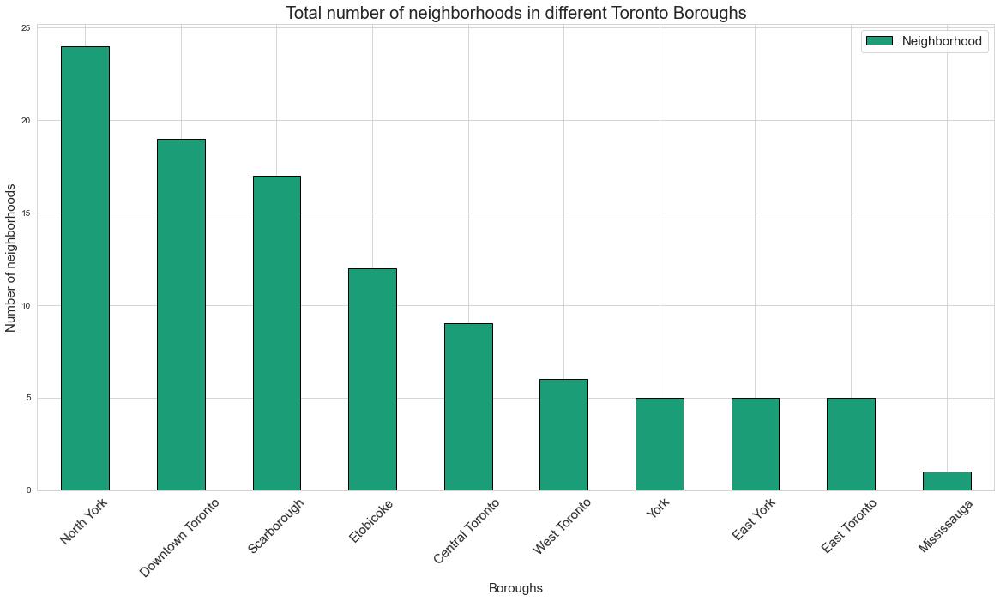

In [44]:
sns.set_style('whitegrid')
sns.set_palette('Dark2')
num_neigh.plot(kind='bar', edgecolor='black', figsize=(20,10))
plt.ylabel('Number of neighborhoods', size=15)
plt.xlabel('Boroughs', size=15)
plt.title('Total number of neighborhoods in different Toronto Boroughs', size=20)
plt.xticks(rotation=45, size=15)
plt.legend(fontsize=15)
plt.show()

In [45]:
toronto_map = folium.Map(location=[latitude, longitude], zoom_start=10)

for lat, lng, borough, neighborhood in zip(toronto_df['Latitude'], toronto_df['Longitude'], toronto_df['Borough'],
                                          toronto_df['Neighborhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
    [lat, lng],
    radius=5,
    popup=label,
    color='blue',
    fill=True,
    fill_color='blue',
    fill_opacity=0.7,
    parse_html=False).add_to(toronto_map)
    
toronto_map

### 4.2. Expolore East and Southeast Asian population in Toronto <a name='eastasia'></a>

In [46]:
eastasia.head()

,Neighborhood,Neighbourhood Number,Population
6,Agincourt North,129.0,18575.0
7,Agincourt South-Malvern West,128.0,13075.0
8,Alderwood,20.0,1295.0
9,Annex,95.0,3945.0
10,Banbury-Don Mills,42.0,6920.0


City of Toronto Neighbourhood Profiles use this Census data to provide a portrait of the demographic, social and economic characteristics of the people and households in each City of Toronto neighbourhood.

Based

In [47]:
eastasia_group = eastasia.groupby('Neighborhood')['Population'].sum().sort_values(ascending=False).to_frame()
eastasia_group

,Population
Neighborhood,
Willowdale East,24815.0
Milliken,20360.0
L'Amoreaux,19680.0
Steeles,18780.0
Agincourt North,18575.0
Waterfront Communities-The Island,13710.0
Agincourt South-Malvern West,13075.0
Tam O'Shanter-Sullivan,11750.0
Don Valley Village,10660.0


Based on that information I would like to show 10 the most highly populated neighborhoods in East and Southeast Asian origins and in other hand 10 neighborhoods with the lowest density in East and Southeast Asian orgins. 

In [48]:
asia_top10 = eastasia_group[eastasia_group['Population'] > 10000.0]
asia_top10

,Population
Neighborhood,
Willowdale East,24815.0
Milliken,20360.0
L'Amoreaux,19680.0
Steeles,18780.0
Agincourt North,18575.0
Waterfront Communities-The Island,13710.0
Agincourt South-Malvern West,13075.0
Tam O'Shanter-Sullivan,11750.0
Don Valley Village,10660.0


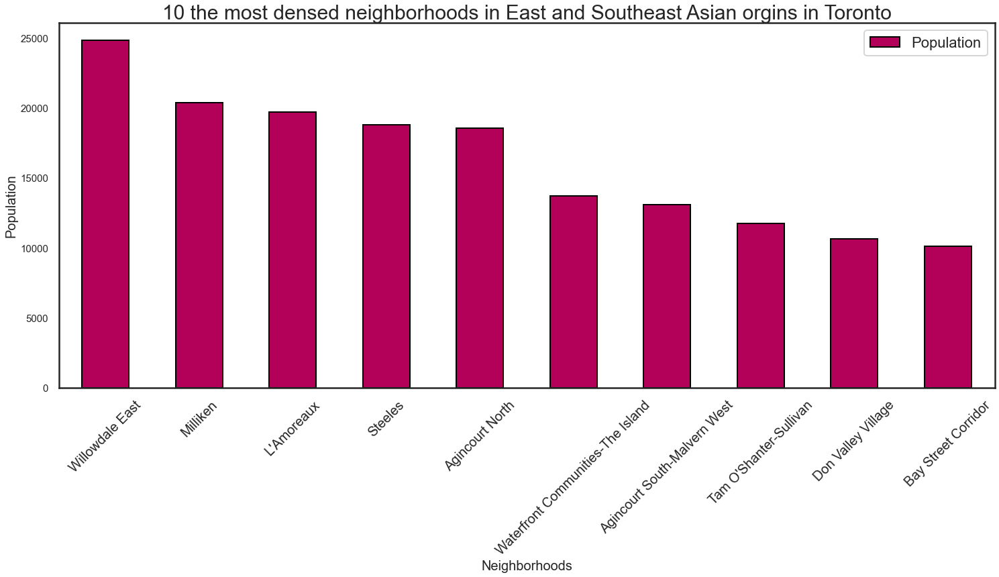

In [49]:
sns.set_style('white')
sns.set_context('poster')
asia_top10.plot(kind='bar', edgecolor='black', figsize=(25,10), color='#b30059')
plt.xlabel('Neighborhoods', size=20)
plt.ylabel('Population', size=20)
plt.title('10 the most densed neighborhoods in East and Southeast Asian orgins in Toronto', size=30)
plt.xticks(rotation=45, size=20)
plt.yticks(size=20)
plt.yticks(size=15)
plt.show()

In [50]:
asia_last10 = eastasia_group[eastasia_group['Population'] <= 900.0]
asia_last10

,Population
Neighborhood,
Runnymede-Bloor West Village,900.0
Playter Estates-Danforth,895.0
Rustic,860.0
Beechborough-Greenbrook,840.0
Casa Loma,825.0
Markland Wood,755.0
Thistletown-Beaumond Heights,710.0
Kingsway South,705.0
Lambton Baby Point,510.0


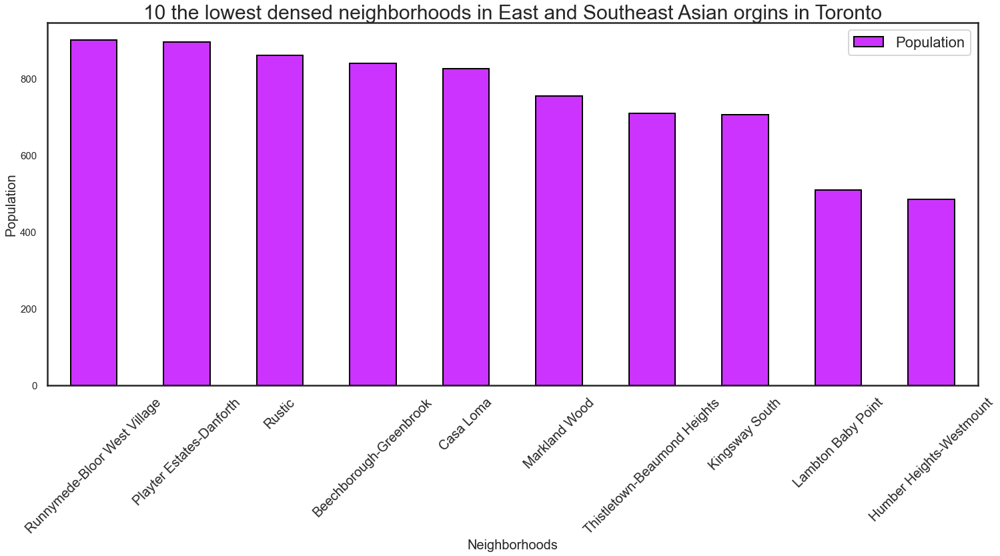

In [51]:
sns.set_style('white')
sns.set_context('poster')
asia_last10.plot(kind='bar', edgecolor='black', figsize=(25,10), color='#cc33ff')
plt.xlabel('Neighborhoods', size=20)
plt.ylabel('Population', size=20)
plt.title('10 the lowest densed neighborhoods in East and Southeast Asian orgins in Toronto', size=30)
plt.xticks(rotation=45, size=20)
plt.yticks(size=20)
plt.yticks(size=15)
plt.show()

### 4.3. Explore Japanese Restaurants in Toronto <a name='japan'><a/>

In [52]:
toronto_japan = pd.read_csv('toronto_japan.csv')
toronto_japan.head()

,Unnamed: 0,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue Name,Venue Latitude,Venue Longitude,Venue Category
0,0,Parkwoods,43.753259,-79.329656,Matsuda Japanese Cuisine & Teppanyaki,43.745494,-79.345821,Japanese Restaurant
1,1,Parkwoods,43.753259,-79.329656,Gonoe Sushi,43.745737,-79.345991,Japanese Restaurant
2,2,Parkwoods,43.753259,-79.329656,Sushi Ichiban,43.758912,-79.310811,Japanese Restaurant
3,3,Parkwoods,43.753259,-79.329656,Teriyaki Experience,43.754468,-79.351424,Japanese Restaurant
4,4,Parkwoods,43.753259,-79.329656,Katsura Japanese Restaurant 桂,43.756259,-79.349571,Japanese Restaurant


I will remove first column contains index 

In [53]:
toronto_japan = toronto_japan.drop('Unnamed: 0', 1)

In [54]:
toronto_japan.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue Name,Venue Latitude,Venue Longitude,Venue Category
0,Parkwoods,43.753259,-79.329656,Matsuda Japanese Cuisine & Teppanyaki,43.745494,-79.345821,Japanese Restaurant
1,Parkwoods,43.753259,-79.329656,Gonoe Sushi,43.745737,-79.345991,Japanese Restaurant
2,Parkwoods,43.753259,-79.329656,Sushi Ichiban,43.758912,-79.310811,Japanese Restaurant
3,Parkwoods,43.753259,-79.329656,Teriyaki Experience,43.754468,-79.351424,Japanese Restaurant
4,Parkwoods,43.753259,-79.329656,Katsura Japanese Restaurant 桂,43.756259,-79.349571,Japanese Restaurant


In [55]:
toronto_japan['Venue Category'].nunique()

20

In [56]:
toronto_japan.groupby('Venue Category')['Venue Category'].count().sort_values(ascending=False).to_frame()

,Venue Category
Venue Category,
Japanese Restaurant,1464
Sushi Restaurant,850
Ramen Restaurant,110
Asian Restaurant,38
Restaurant,37
Hawaiian Restaurant,13
Steakhouse,12
Bakery,7
Korean Restaurant,6


From the table below we can clearly see that in dataframe `toronto_japan` exists 20 different venue category.

We are only interested in one category equal to `Japanese Restaurant`, so I will choose for further analysis only this venue category. 

In [57]:
toronto_japan = toronto_japan[toronto_japan['Venue Category'] == 'Japanese Restaurant']
toronto_japan.shape

(1464, 7)

In [58]:
toronto_japan.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue Name,Venue Latitude,Venue Longitude,Venue Category
0,Parkwoods,43.753259,-79.329656,Matsuda Japanese Cuisine & Teppanyaki,43.745494,-79.345821,Japanese Restaurant
1,Parkwoods,43.753259,-79.329656,Gonoe Sushi,43.745737,-79.345991,Japanese Restaurant
2,Parkwoods,43.753259,-79.329656,Sushi Ichiban,43.758912,-79.310811,Japanese Restaurant
3,Parkwoods,43.753259,-79.329656,Teriyaki Experience,43.754468,-79.351424,Japanese Restaurant
4,Parkwoods,43.753259,-79.329656,Katsura Japanese Restaurant 桂,43.756259,-79.349571,Japanese Restaurant


Now I am able to do some visualisation. 

First I will modify the table above to get information only about `Neighborhood` and `Venue`

In [59]:
japan_neigh = toronto_japan[['Neighborhood', 'Venue Name']].groupby(['Neighborhood']).size().reset_index(name='Number of Japanese Restaurants')

In [60]:
japan_neigh.sort_values('Number of Japanese Restaurants', ascending=False, inplace=True)

In [61]:
japan_neigh = japan_neigh.reset_index().drop('index', axis=1).set_index('Neighborhood')
japan_neigh

,Number of Japanese Restaurants
Neighborhood,
Queen's Park,72
"Harbord, University of Toronto",67
Church and Wellesley,67
Central Bay Street,67
"Ryerson, Garden District",67
"Adelaide, King, Richmond",65
Berczy Park,65
"Chinatown, Grange Park, Kensington Market",65
"First Canadian Place, Underground city",65


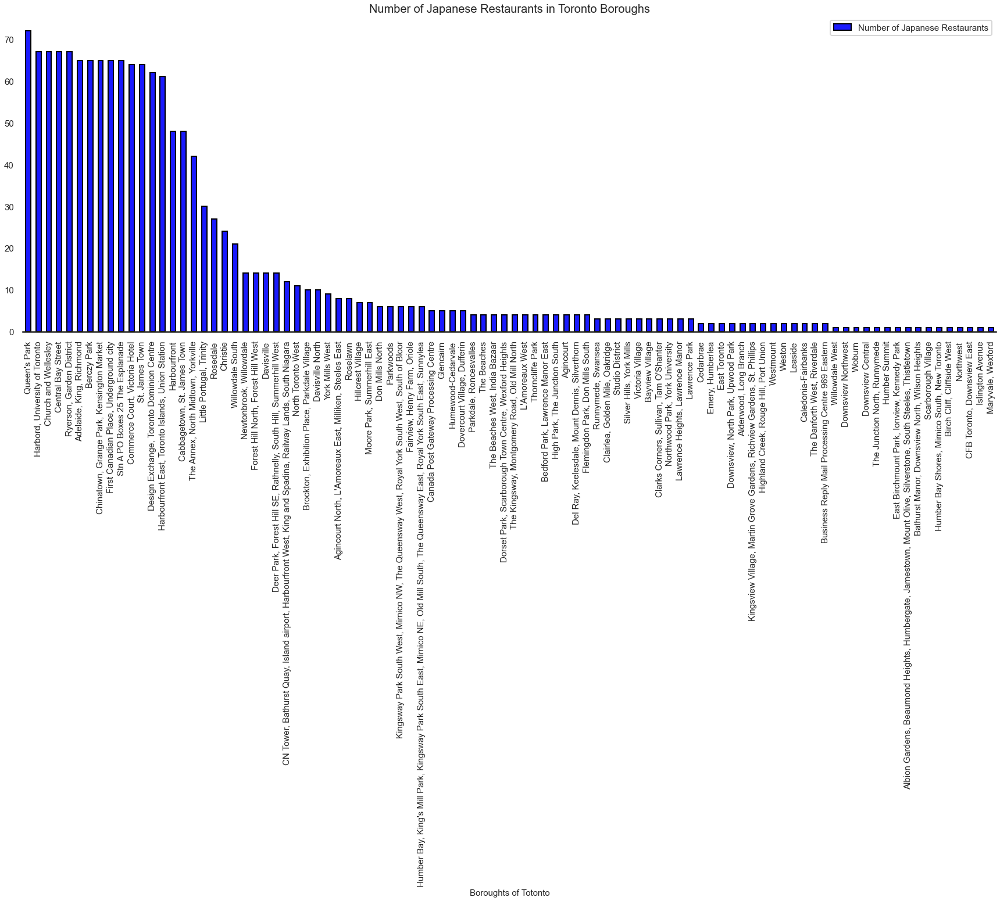

In [62]:
# plot

ax = japan_neigh.plot(kind='bar', figsize=(30,10), color='#1a1aff', edgecolor='black')

# set title and legend
ax.set_title('Number of Japanese Restaurants in Toronto Boroughs', size=20)
ax.set_xlabel('Boroughts of Totonto', size=15)
ax.legend(loc='upper right', fontsize=15)
ax.tick_params(axis="x", labelsize=15)
ax.tick_params(axis="y", labelsize=15)

# remove borders from plot
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.yaxis.set_visible(True)

# remove background
sns.set_style('white')


Secondly I would like to get not only information about different japanese restaurants in neighborhoods but also in different boroughs in Toronto so I will merge two dataframes using `left join`

In [63]:
jpn = pd.merge(toronto_df, japan_neigh, how = 'right', on = ['Neighborhood'] )
jpn

,PostalCode,Borough,Neighborhood,Latitude,Longitude,Number of Japanese Restaurants
0,M3A,North York,Parkwoods,43.753259,-79.329656,6
1,M4A,North York,Victoria Village,43.725882,-79.315572,3
2,M5A,Downtown Toronto,Harbourfront,43.654260,-79.360636,48
3,M6A,North York,"Lawrence Heights, Lawrence Manor",43.718518,-79.464763,3
4,M7A,Downtown Toronto,Queen's Park,43.662301,-79.389494,72
5,M9A,Etobicoke,Islington Avenue,43.667856,-79.532242,1
6,M3B,North York,Don Mills North,43.745906,-79.352188,6
7,M5B,Downtown Toronto,"Ryerson, Garden District",43.657162,-79.378937,67
8,M6B,North York,Glencairn,43.709577,-79.445073,5
9,M1C,Scarborough,"Highland Creek, Rouge Hill, Port Union",43.784535,-79.160497,2


In [64]:
jpn_boro = jpn[['Borough', 'Number of Japanese Restaurants']].groupby(['Borough']).sum().sort_values('Number of Japanese Restaurants', ascending=False)
jpn_boro

,Number of Japanese Restaurants
Borough,
Downtown Toronto,1075
Central Toronto,123
North York,107
West Toronto,56
Scarborough,35
Etobicoke,26
East Toronto,15
York,14
East York,8


Text(1.7, 900, 'Japanese Restaurants are everywhere in Downtown Toronto')

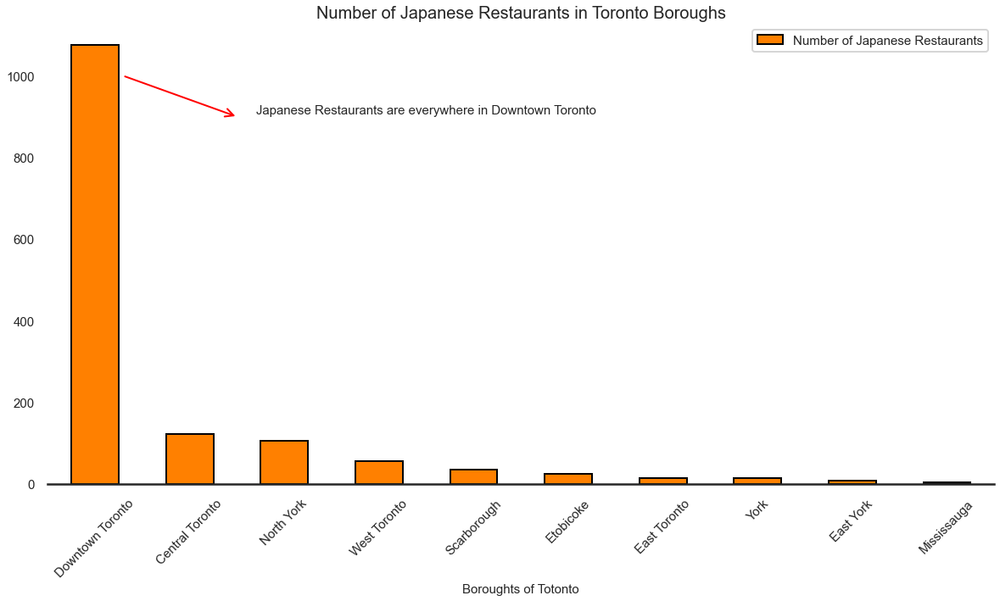

In [65]:
# plot

ax = jpn_boro.plot(kind='bar', figsize=(20,10), color='#ff8000', edgecolor='black')

# set title and legend
ax.set_title('Number of Japanese Restaurants in Toronto Boroughs', size=20)
ax.set_xlabel('Boroughts of Totonto', size=15)
ax.legend(loc='upper right', fontsize=15)
ax.tick_params(axis="x", labelsize=15, rotation=45)
ax.tick_params(axis="y", labelsize=15)

# remove borders from plot
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.yaxis.set_visible(True)

# remove background
sns.set_style('white')

# Annotate arrow

plt.annotate('',
            xy=(0.3, 1000), # place head of the arrow at point
            xytext=(1.5, 900), # place base of the arrow at point
            xycoords='data', # use the coordinate system of the object being annotated 
            arrowprops=dict(arrowstyle='<-', connectionstyle='arc3', color='red', lw=2))

# Annotate Text
plt.annotate('Japanese Restaurants are everywhere in Downtown Toronto', # text to display
             xy=(1.7, 900),             # start the text at at point 
             va='bottom',               # want the text to be vertically 'bottom' aligned
             ha='left',                 # want the text to be horizontally 'left' algned
             fontsize=15
            )

**Summary:** 
* From the first graph above we know that there is 2 neighborhoods where number of japanese restaurants is above 70, 2 where number of japanese restaurants is above 60 and 16 where the number is equal to 1. However further analysis is difficult because the total number of neighborhoods in Toronto is 103, so better idea is to get look at total number of japanese restaurants in different boroughts in Toronto.
* In the other hand the second graph above shows us total number of japanese restaurants in different Toronto's borough. It is more clear and visible to analysis. We can observe that the highest number of japanese restaurants are in Downtown Toronto with total number equal to 1109.
* On the second, third and fourth place with highest number of japanese restaurants are: Central Toronto, North York and West Toronto. 
* What is absolutely worth to notice is a fact that the density of japanese restaurants is the highest in central Toronto boroughs with relatively small amount of japanese restaurants on the outskirts of Toronto. 

### 4.4. Create a choropleth map of Toronto with Japanese Restaurants <a name='map'><a/>

In [66]:
# Create choropleth map
c = folium.Map(location=[latitude,longitude], tiles='cartodbpositron', zoom_start=11)

# Add choropleth to the map, set as 
c.choropleth(
    geo_data=geo_toronto,
    data = eastasia,
    columns=['Neighbourhood Number','Population'],
    key_on='feature.properties.AREA_SHORT_CODE',
    line_weight = 0.2,
    fill_color='YlOrBr',
    fill_opacity= 0.3,
    line_opacity= 0.2, 
    legend_name='Population of East and Southeast Asian origins',
    name = 'Choropleth Map of Neighborhoods')

ward_style = lambda x: {'fillColor': '#aeaeae', 'color': '#aeaeae','fillOpacity':'0.1'}
folium.GeoJson(
    ward_geo,
    style_function = ward_style,
    name='Neighborhoods 44 Model'
).add_to(c)

# add the Japanese Restaurants as red circle markers:
for index,row in toronto_japan.iterrows():
    folium.CircleMarker(
        [row["Venue Latitude"], row["Venue Longitude"]],
        radius=2,
        color='red',
        fill= True,
        fill_color='red',
        fill_opacity= 0.1,
        popup='Japanese Restaurant',
    ).add_to(c)
c

According to the map above we can conclude that the higher number of japanese restaurants is positively correlated with East and Southeast Asian population in Toronto. We can also see high density of japanese restaurants in city center of Toronto. 

### 4.5. Create a heatmap for Japanese Restaurants <a name='heat'><a/>

In [67]:
# convert to (n, 2) nd-array format for heatmap

toronto_arr = toronto_japan[['Venue Latitude', 'Venue Longitude']].values
toronto_arr = toronto_arr.tolist()

In [68]:
# plot heatmap

folium.plugins.HeatMap(toronto_arr, radius=15).add_to(c)
c

### 4.6. Create map of Business Improvement Area of Toronto with Japanese Restaurants <a name='bia'><a/>

**Note:** A Business Improvement Area (BIA) is an association of commercial property owners and tenants within a defined area who work in partnership with the City to create thriving, competitive, and safe business areas that attract shoppers, diners, tourists, and new businesses.

In [69]:
# Create map for Toronto Business Improvement Area

f = folium.Map(location=[latitude,longitude], tiles='cartodbpositron', zoom_start=10)


# add the Japanese Restaurants as brown circle markers:
for index,row in toronto_japan.iterrows():
    folium.CircleMarker(
        [row["Venue Latitude"], row["Venue Longitude"]],
        radius=2,
        color='green',
        fill= True,
        fill_color='green',
        fill_opacity= 0.1,
        popup='Japanese Restaurant',
    ).add_to(f)
f

ward_style = lambda x: {'fillColor': 'red', 'color': 'red','fillOpacity':'0.1'}
folium.GeoJson(
    ward_geo,
    style_function = ward_style,
    name='Neighborhoods 44 Model'
).add_to(f)

area_style = lambda x: {'fillColor': 'black', 'color': 'black','fillOpacity':'0.2'}
folium.GeoJson(
    geo_area,
    style_function = area_style,
    name='Business Improvement Areas'
).add_to(f)
f

## 5. Density based Clustering DBSCAN <a name='db'></a>

**DBSCAN** - a density-based clustering algorithm which is appropriate to use when examining spatial data. Most of the traditional clustering techniques such as K-Means clustering can be used to group data in an unsupervised way, however, when applied to tasks with arbitrary shaped clusters or clusters within clusters, traditional techniques might not be able to achieve good results, and elements in the same cluster might not share enough similarity or the performance may be poor. Density-based clustering algorithms locate regions of high density that are separated from one another by regions of low density.

Now let's continue searching for optimal locations for Japanese restaurants using DBSCAN algorithm. 

Advantages of using DBSCAN algorithm: 

* Unlike K-means, DBSCAN does not require the user to specify the number of clusters to be generated
* DBSCAN can find any shape of clusters. The cluster doesn’t have to be circular.
* DBSCAN can identify outliers

### 5.1. Data preparation for DBSCAN <a name='prep'></a>

In [70]:
toronto_japan.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue Name,Venue Latitude,Venue Longitude,Venue Category
0,Parkwoods,43.753259,-79.329656,Matsuda Japanese Cuisine & Teppanyaki,43.745494,-79.345821,Japanese Restaurant
1,Parkwoods,43.753259,-79.329656,Gonoe Sushi,43.745737,-79.345991,Japanese Restaurant
2,Parkwoods,43.753259,-79.329656,Sushi Ichiban,43.758912,-79.310811,Japanese Restaurant
3,Parkwoods,43.753259,-79.329656,Teriyaki Experience,43.754468,-79.351424,Japanese Restaurant
4,Parkwoods,43.753259,-79.329656,Katsura Japanese Restaurant 桂,43.756259,-79.349571,Japanese Restaurant


In [71]:
toronto_japan.shape

(1464, 7)

In [72]:
toronto_japan.dtypes

Neighborhood               object
Neighborhood Latitude     float64
Neighborhood Longitude    float64
Venue Name                 object
Venue Latitude            float64
Venue Longitude           float64
Venue Category             object
dtype: object

First I will clean coordinates data for each venue from toronto_japan dataframe

In [73]:
xs, ys = np.asarray(toronto_japan['Venue Latitude']), np.asarray(toronto_japan['Venue Longitude'])
toronto_japan['xm'] = xs.tolist()
toronto_japan['ym'] = ys.tolist()

In [74]:
cluster_data = toronto_japan[['xm', 'ym']]
cluster_data = np.nan_to_num(cluster_data)
cluster_data

array([[ 43.74549367, -79.34582141],
       [ 43.74573682, -79.3459912 ],
       [ 43.75891159, -79.31081063],
       ...,
       [ 43.6247282 , -79.50990398],
       [ 43.625863  , -79.504237  ],
       [ 43.62598209, -79.50349796]])

### 5.2. DBSCAN Modeling <a name='model'></a>

As is the case in most machine learning algorithm, the model's behaviour is dictated by several parameters. In this example, I will touch the following three:

* **eps:** two points are considered neighbors if the distance between the two points is below the threshold epsilon
* **min_samples:** the minimum number of neighbors a given point should have in order to be classified as core point
* **metric:** the metric to use when calculating distance between instances in a feature array (i.e. **default: euclidean distance**)

One limitation of DBSCAN is that it is sensitive to the choice of eps, in particular if clusters have different densities. If eps is too small, sparser clusters will be defined as noise. If eps is too large, denser clusters may be merged together.

In [75]:
neigh = NearestNeighbors(n_neighbors=len(cluster_data))
nbrs = neigh.fit(cluster_data)
distances, indices = nbrs.kneighbors(cluster_data)

In [76]:
distances.mean()

0.04923836133978319

In [77]:
distances = np.sort(distances, axis=0)
distances

array([[0.        , 0.        , 0.        , ..., 0.21937502, 0.24507287,
        0.26001504],
       [0.        , 0.        , 0.        , ..., 0.21937502, 0.24507287,
        0.26001504],
       [0.        , 0.        , 0.        , ..., 0.21937502, 0.24507287,
        0.26001504],
       ...,
       [0.        , 0.02950121, 0.0397782 , ..., 0.43388445, 0.48752557,
        0.51369044],
       [0.        , 0.03008682, 0.06348845, ..., 0.48200542, 0.49000681,
        0.51604811],
       [0.        , 0.0328192 , 0.08893967, ..., 0.50813462, 0.51369044,
        0.51604811]])

In [78]:
# take the last column
distances = distances[:,-1]

Text(1200, 0.38, 'Optimal Epsilon Value')

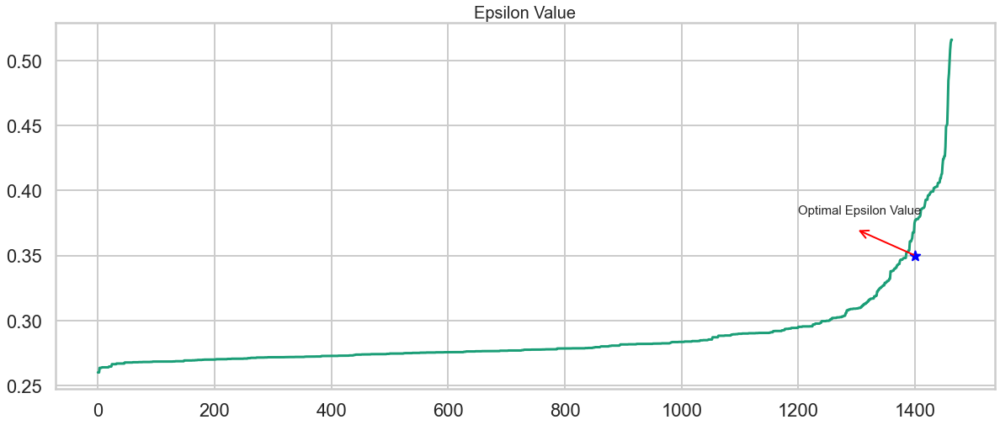

In [79]:
sns.set_style('whitegrid')
sns.set_context('poster')
sns.set_palette('Dark2')
plt.figure(figsize=(20,8))
plt.plot(distances)
plt.scatter(x=1400, y=0.35, color='blue', marker='*')
plt.title('Epsilon Value', size=20)

# Annotate arrow

plt.annotate('',
            xy=(1400, 0.35), # place head of the arrow at point
            xytext=(1300, 0.37), # place base of the arrow at point
            xycoords='data', # use the coordinate system of the object being annotated 
            arrowprops=dict(arrowstyle='<-', connectionstyle='arc3', color='red', lw=2))

# Annotate Text
plt.annotate('Optimal Epsilon Value', # text to display
             xy=(1200, 0.38),             # start the text at at point 
             va='bottom',               # want the text to be vertically 'bottom' aligned
             ha='left',                 # want the text to be horizontally 'left' algned
             fontsize=15
            )

The optimal value for epsilon will be found at the point of maximum curvature. In this case **eps = 0.35**

In [80]:
cluster_data = StandardScaler().fit_transform(cluster_data)

In [81]:
db = DBSCAN(eps=0.35, min_samples=6).fit(cluster_data)
labels = db.labels_
labels

array([ 0,  0, -1, ..., 10, 10, 10], dtype=int64)

### 5.3. Distinguish outliers <a name='out'></a>

In [82]:
core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_
toronto_japan["Cluster_DB"]=labels

realClusterNum=len(set(labels)) - (1 if -1 in labels else 0)
clusterNum = len(set(labels))

In [83]:
toronto_japan[['Neighborhood', 'Venue Name', 'Cluster_DB']]

,Neighborhood,Venue Name,Cluster_DB
0,Parkwoods,Matsuda Japanese Cuisine & Teppanyaki,0
1,Parkwoods,Gonoe Sushi,0
2,Parkwoods,Sushi Ichiban,-1
3,Parkwoods,Teriyaki Experience,0
4,Parkwoods,Katsura Japanese Restaurant 桂,0
5,Parkwoods,Gyu-Kaku,5
7,Victoria Village,Tatami Sushi,-1
8,Victoria Village,Kaiseki Yu-Zen Hashimoto,1
9,Victoria Village,Teriyaki Experience,-1
11,Harbourfront,Kinka Izakaya Original,2


As you can see for outliers, the cluster label is -1

In [84]:
set(labels)

{-1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10}

In [85]:
# define k_clusters
toronto_japan['Cluster_DB'] = toronto_japan['Cluster_DB'].astype(int).tolist()
k_clusters = toronto_japan['Cluster_DB'].max() + 1 
k_clusters

11

In [86]:
toronto_japan.dtypes

Neighborhood               object
Neighborhood Latitude     float64
Neighborhood Longitude    float64
Venue Name                 object
Venue Latitude            float64
Venue Longitude           float64
Venue Category             object
xm                        float64
ym                        float64
Cluster_DB                  int64
dtype: object

In [87]:
toronto_japan.groupby('Cluster_DB')['Venue Name'].count().sort_values(ascending=False).to_frame()

,Venue Name
Cluster_DB,
2,1241
-1,113
6,40
0,13
10,8
9,8
7,8
3,8
1,7


### 5.4. DBSCAN Visualization <a name='vis'></a>

In [88]:
x = np.arange(k_clusters)
ys = [i + x + (i*x)**2 for i in range(k_clusters)]
colors_array = cm.tab20(np.linspace(0, 1, len(ys)))
rainbow = [col.rgb2hex(i) for i in colors_array]

db_map = folium.Map(location=[latitude, longitude], zoom_start=10)

for lat, lon, neigh, cluster in zip(toronto_japan['Venue Latitude'], toronto_japan['Venue Longitude'],
                                    toronto_japan['Neighborhood'], toronto_japan['Cluster_DB']):
    label = folium.Popup(str(neigh) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-0],
        fill=True,
        fill_color=rainbow[cluster-0],
        fill_opacity=0.7).add_to(db_map)
    
db_map

In [89]:
# set color scheme for the clusters
x = np.arange(k_clusters)
ys = [i + x + (i*x)**2 for i in range(k_clusters)]
colors_array = cm.tab20(np.linspace(0, 1, len(ys)))
rainbow = [col.rgb2hex(i) for i in colors_array]



f.choropleth(
    geo_data=geo_toronto,
    data = eastasia,
    columns=['Neighbourhood Number','Population'],
    key_on='feature.properties.AREA_SHORT_CODE',
    line_weight = 0.2,
    fill_color='YlOrBr',
    fill_opacity= 0.3,
    line_opacity= 0.2, 
    legend_name='Population of East and Southeast Asian origins',
    name = 'Choropleth Map of Neighborhoods 140')


# add markers to the map
for lat, lon, neigh, cluster in zip(toronto_japan['Venue Latitude'], toronto_japan['Venue Longitude'],
                                    toronto_japan['Neighborhood'], toronto_japan['Cluster_DB']):
    label = folium.Popup(str(neigh) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-0],
        fill=True,
        fill_color=rainbow[cluster-0],
        fill_opacity=0.7).add_to(f)
f

## 6. Discussion <a name='dis'></a>

After performing DBSCAN algorithm I finally have potential candidates for localisation a new japanese restaurant. Now I have to take into account few things: 

* localisation of Business Improvement Area
* high or low population density in East and Southeast Asian orgins in Toronto
* density of japanese restaurants in each clusters

Outlier identified with number -1 will not be taking into consideration during following analysis. 

* **Cluster 0: Fair**
  * Out of BIA
  * Moderate population density of East and SouthEast Asian origins
  * Moderate density of Japanese Restaurants
  
* **Cluster 1: Not Recommended**
  * Out of BIA
  * Low population density of East and SouthEast Asian origins
  * Low density of Japanese Restaurants
  
* **Cluster 2: Potential**
  * In of BIA
  * High population density of East and SouthEast Asian origins
  * High density of Japanese Restaurants
  
* **Cluster 3: Fair**
  * In of BIA
  * Low population density of East and SouthEast Asian origins
  * Moderate density of Japanese Restaurants
  
* **Cluster 4: Potential**
  * Out of BIA
  * High population density of East and SouthEast Asian origins
  * Low density of Japanese Restaurants
  
* **Cluster 5: Potential**
  * Out of BIA
  * Moderate population density of East and SouthEast Asian origins
  * Low density of Japanese Restaurants

* **Cluster 6: Not Recommended**
  * In of BIA
  * High population density of East and SouthEast Asian origins
  * High density of Japanese Restaurants

* **Cluster 7: Potential**
  * In of BIA
  * Low population density of East and SouthEast Asian origins
  * Low density of Japanese Restaurants

* **Cluster 8: Potential**
  * In of BIA
  * Low population density of East and SouthEast Asian origins
  * Low density of Japanese Restaurants

* **Cluster 9: Not Recommended**
  * Out of BIA
  * High population density of East and SouthEast Asian origins
  * Moderate density of Japanese Restaurants
  
* **Clsuter 10: Fair**
  * In of BIA
  * Low population density of East and SouthEast Asian origins
  * Moderate density of Japanese Restaurants

## 7. Conclusion <a name='con'></a>

Finally I have spotted 5 points with high potential to open new business. Now I give it star label with color blue.

In [90]:
folium.Marker([43.815453, -79.344809], icon=folium.Icon(color='blue', icon='star')).add_to(f)
folium.Marker([43.778330, -79.343110], icon=folium.Icon(color='blue', icon='star')).add_to(f)
folium.Marker([43.732562, -79.404147], icon=folium.Icon(color='blue', icon='star')).add_to(f)
folium.Marker([43.649891, -79.482404], icon=folium.Icon(color='blue', icon='star')).add_to(f)
folium.Marker([43.6230544, -79.394316], icon=folium.Icon(color='blue', icon='star')).add_to(f)
f

The Boroughs that should be taken into account when opening new japanese restaurants are:

* Scarborough 
* North York 
* Downtown Toronto outskirts
* Toronto Islands

**Note:** All of above informations conclude my analysis. I found 4 potential areas to open japanese restaurant. However please notice that there exists thousands of different factors that should be taken into account when opening a new business like: rent prices, average revenue of restaurants in different areas, potential clients accesibility, sales volume, and many many more.

## 8. Limitations <a name='lim'></a>

One of important limitations worth to mention is a fact that data used in this project was obtained from Open Data city of Toronto and their based on Census results from 2016 year. 

Immigration and ethnocultural diversity statistics like neighbourhood profiles data,  Business Improvement Areas data and GeoJSON ward data are based on results of  2016 Census in Canada. 

Current 2021 year are the year for conducting new Census in Canada, so if the data will be available could be use to improve density population map or business improvment area map. New Census data could bring new insight about neighborhoods profiles in city of Toronto. 

## 9. Reference <a name='ref'></a>

[1]https://en.wikipedia.org/w/index.php?title=List_of_postal_codes_of_Canada:_M&oldid=945633050<br>
[2]https://open.toronto.ca/dataset/business-improvement-areas/<br>
[3]https://open.toronto.ca/dataset/neighbourhood-profiles/<br>
[4]https://www.toronto.ca/city-government/data-research-maps/neighbourhoods-communities/ward-profiles/44-ward-model/<br>
[5]https://open.toronto.ca/dataset/neighbourhoods/<br>
[6]https://developer.foursquare.com/<br>
[7]https://towardsdatascience.com/machine-learning-clustering-dbscan-determine-the-optimal-value-for-epsilon-eps-python-example-3100091cfbc<br>
[8]https://scikit-learn.org/stable/modules/generated/sklearn.cluster.DBSCAN.html<br>
[9]https://www.britannica.com/place/Toronto<br>
[10]https://www.google.com/maps/d/viewer?mid=1GVzAjujA652hcRVy7TdHpWwDM3Y&vpsrc=0&ctz=300&ie=UTF8&t=h&oe=UTF8&msa=0&ll=43.724315723883095%2C-79.32511256096308&z=11<br>

## Author

*Paulina Kossowska*